In [ ]:
!pip install tensorflow==2.10.1
!pip install imageio

In [2]:
!pip install pillow-avif-plugin

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.5/8.5 MB 65.1 MB/s eta 0:00:00:00:010:01


In [ ]:
from __future__ import absolute_import, division, print_function, unicode_literals
from glob import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import PIL
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model
import time
from IPython import display
from PIL import Image
import pillow_avif
import matplotlib.gridspec as gridspec

In [4]:
#Global Variable
BATCH_SIZE = 4
batch_size = 4
epochs = 90
IMG_H, IMG_W = 128, 128
latent_dim = 128

# Data Preprocessing Function

In [5]:
#create folder for save augmented images
def create_dir(path):
    if not os.path.exists(path):
        os.makedirs(path)

In [6]:
def load_image(image_path):
    img = tf.io.read_file(image_path)
    #img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.decode_png(img, channels=3)
    img = tf.image.resize(img, [IMG_H, IMG_W])
    img = tf.cast(img, tf.float32)
    img = (img - 127.5) / 127.5
    return img

In [7]:
def tf_dataset(images_path, batch_size=4):
    dataset = tf.data.Dataset.list_files(path, shuffle=False)
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=1000)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset

In [8]:
def save_plot(examples, epochs, n):
    examples = (examples + 1) / 2.0
    for i in range(n*n):
        plt.subplot(n,n, i+1)
        plt.axis("off")
        plt.imshow(examples[i])
    filename = f"samples/fake_image_epochs_{epochs+1}.png"
    plt.savefig(filename)
    plt.show()

# Avif to Jpeg

In [9]:
create_dir("/kaggle/working/nft-data")

In [10]:
images = sorted(glob("/kaggle/input/clonex-nft-collectibles-image-dataset/CloneX/*"))

In [ ]:
for i in range(len(images)):
    print(i)
    try:
        img = Image.open(images[i])
        img.save(f'/kaggle/working/nft-data/images_{i}.jpeg')
    except Exception as e:
        print(f"Error converting image '{images[i]}': {e}")
        continue

# Data Preprocessing

In [12]:
path = "/kaggle/working/nft-data/*"

In [13]:
images_ds = tf_dataset(path, 128)

In [14]:
for i in images_ds.take(1):
    print(i.numpy().shape)

(128, 128, 128, 3)


# Visualtize the Images

In [15]:
temp = sorted(glob(path))

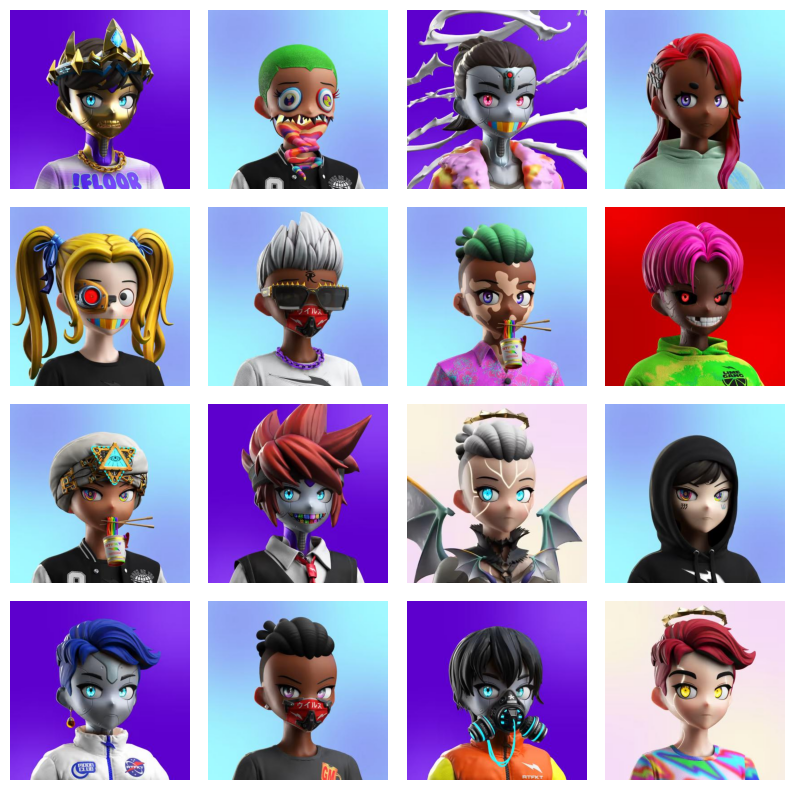

In [16]:
num_rows = 4
num_cols = 4
fig = plt.figure(figsize=(10, 10))
gs = gridspec.GridSpec(num_rows, num_cols, wspace=0.1, hspace=0.1)

for i in range(num_rows * num_cols):
    ax = plt.subplot(gs[i])
    image_path = temp[i]
    
    # Read and display the image using PIL
    image = Image.open(image_path)
    plt.imshow(np.asarray(image))
    plt.axis("off")

# Model

In [17]:
w_init = tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

In [18]:
def deconv_block(inputs, num_filters, kernel_size, strides, bn=True):
    x = layers.Conv2DTranspose(filters=num_filters,
                       kernel_size=kernel_size,
                       kernel_initializer=w_init,
                       padding='same',
                       strides=strides,
                       use_bias=False)(inputs)
    if bn:
        x = layers.BatchNormalization()(x)
        x = layers.LeakyReLU(alpha=0.2)(x)
        
    return x

In [19]:
def conv_block(inputs, num_filters, kernel_size, padding='same', strides=2, activation=True):
    x = layers.Conv2D(num_filters, kernel_size=kernel_size, kernel_initializer=w_init, padding=padding, strides=strides)(inputs)
    if activation:
        x = layers.LeakyReLU(alpha=0.2)(x)
        x = layers.Dropout(0.3)(x)
    return x

## Generator

In [20]:
def generator(latent_dim):
    f = [2**i for i in range(5)][::-1]
    filters = 32
    output_strides = 16
    h_output = IMG_H // output_strides
    w_output = IMG_W // output_strides

    noise = layers.Input(shape=(latent_dim,), name="generator_noise_input")

    x = layers.Dense(f[0] * filters * h_output * w_output, use_bias=False)(noise)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)
    x = layers.Reshape((h_output, w_output, 16 * filters))(x)

    for i in range(1, 5):
        x = deconv_block(x,
            num_filters=f[i] * filters,
            kernel_size=5,
            strides=2,
            bn=True
        )

    x = conv_block(x,
        num_filters=3,  
        kernel_size=5,
        strides=1,
        activation=False
    )
    fake_output = layers.Activation("tanh")(x)

    return Model(noise, fake_output, name="generator")

## Discriminator

In [21]:
def discriminator():
    f = [2**i for i in range(4)]
    image_input = layers.Input(shape=(IMG_H, IMG_W, 3))
    x = image_input
    filters = 64
    output_strides = 16
    h_output = IMG_H // output_strides
    w_output = IMG_W // output_strides

    for i in range(0, 4):
        x = conv_block(x, num_filters=f[i] * filters, kernel_size=5, strides=2)

    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)

    return Model(image_input, x, name="discriminator")

In [22]:
class GAN(Model):
    def __init__(self, discriminator, generator, latent_dim):
        super(GAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        
    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(GAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        for _ in range(2):
            ## Train the discriminator
            random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
            generated_images = self.generator(random_latent_vectors)
            generated_labels = tf.zeros((batch_size, 1))

            with tf.GradientTape() as ftape:
                predictions = self.discriminator(generated_images)
                d1_loss = self.loss_fn(generated_labels, predictions)
            grads = ftape.gradient(d1_loss, self.discriminator.trainable_weights)
            self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

            ## Train the discriminator
            labels = tf.ones((batch_size, 1))

            with tf.GradientTape() as rtape:
                predictions = self.discriminator(real_images)
                d2_loss = self.loss_fn(labels, predictions)
            grads = rtape.gradient(d2_loss, self.discriminator.trainable_weights)
            self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        ## Train the generator
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        misleading_labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as gtape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = gtape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        return {"d1_loss": d1_loss, "d2_loss": d2_loss, "g_loss": g_loss}

In [23]:
disc = discriminator()
gen = generator(latent_dim)

/opt/conda/lib/python3.10/site-packages/keras/initializers/initializers_v2.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values  each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initalizer instance more than once.
  warnings.warn(


In [24]:
#GAN
gan = GAN(disc, gen, latent_dim)

In [25]:
#loss and optimizer
bce_loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True, label_smoothing=0.1)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
g_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
gan.compile(d_optimizer, g_optimizer, bce_loss_fn)

In [26]:
create_dir("/kaggle/working/samples")

# Training

epochs 0
1/1 [==============================] - 0s 349ms/step


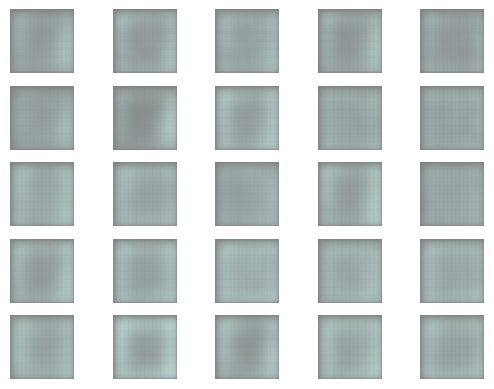

epochs 1
1/1 [==============================] - 0s 20ms/step


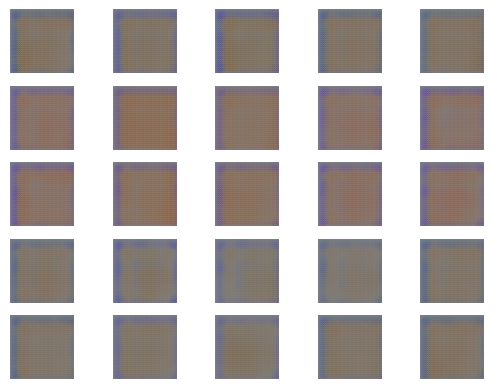

epochs 2
1/1 [==============================] - 0s 32ms/step


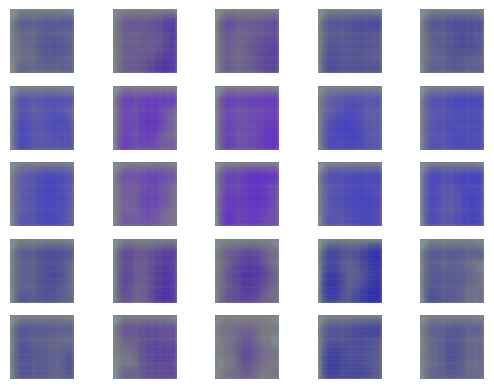

epochs 3
1/1 [==============================] - 0s 21ms/step


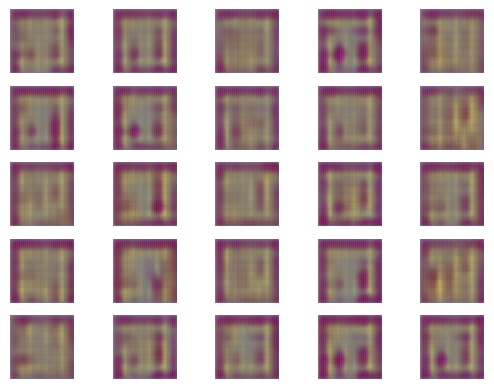

epochs 4
1/1 [==============================] - 0s 21ms/step


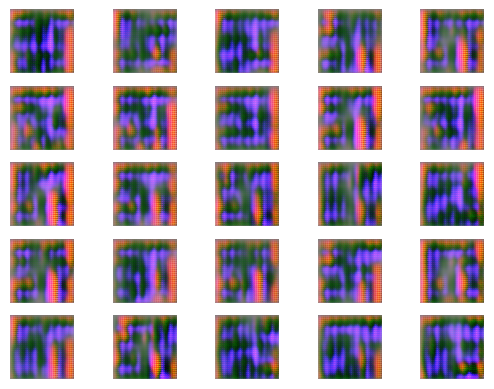

epochs 5
1/1 [==============================] - 0s 22ms/step


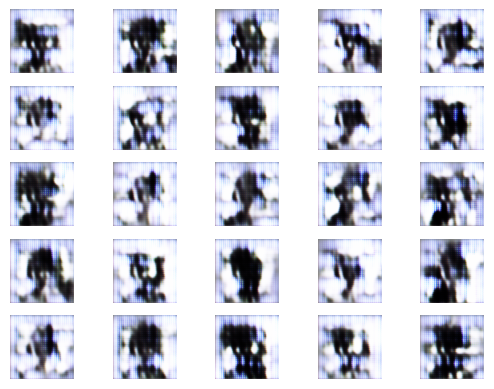

epochs 6
1/1 [==============================] - 0s 22ms/step


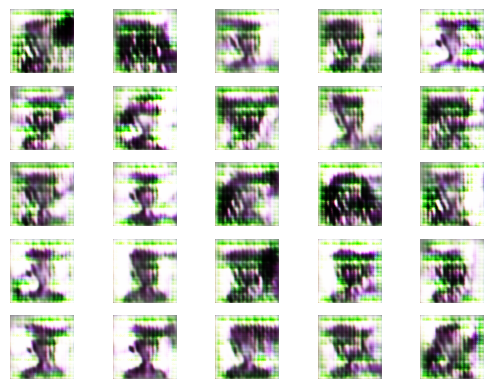

epochs 7
1/1 [==============================] - 0s 31ms/step


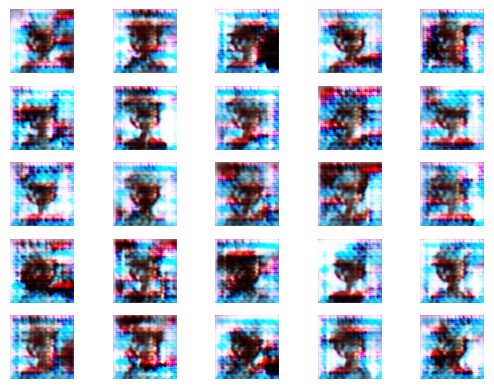

epochs 8
1/1 [==============================] - 0s 20ms/step


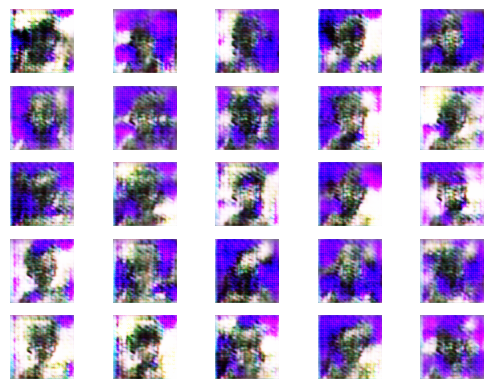

epochs 9
1/1 [==============================] - 0s 27ms/step


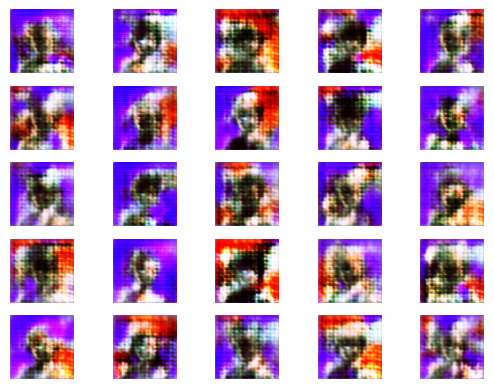

epochs 10
1/1 [==============================] - 0s 20ms/step


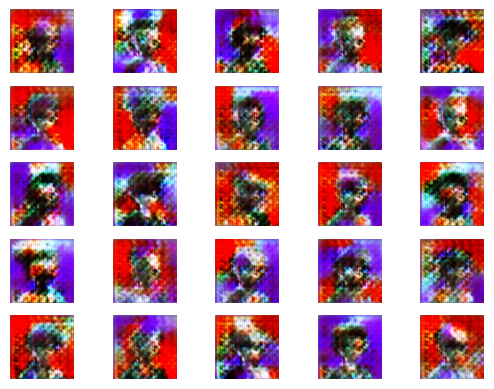

epochs 11
1/1 [==============================] - 0s 21ms/step


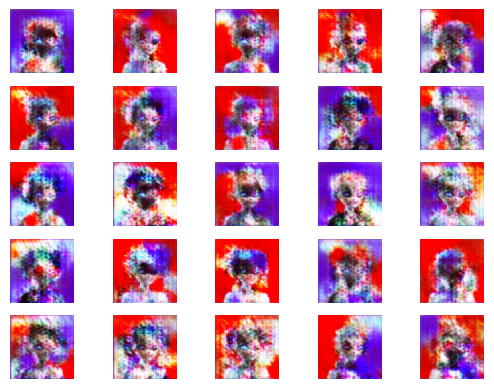

epochs 12
1/1 [==============================] - 0s 21ms/step


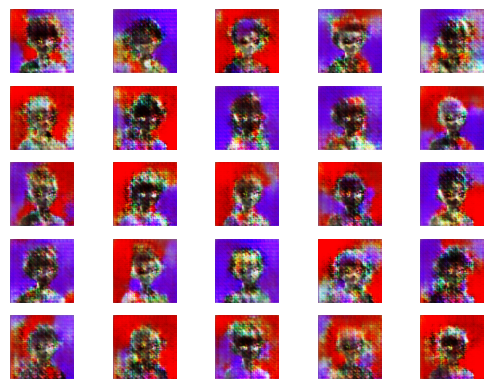

epochs 13
1/1 [==============================] - 0s 21ms/step


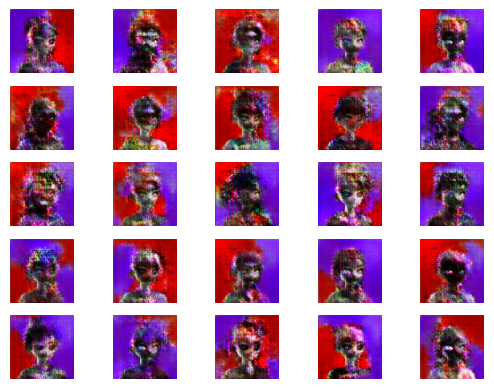

epochs 14
1/1 [==============================] - 0s 20ms/step


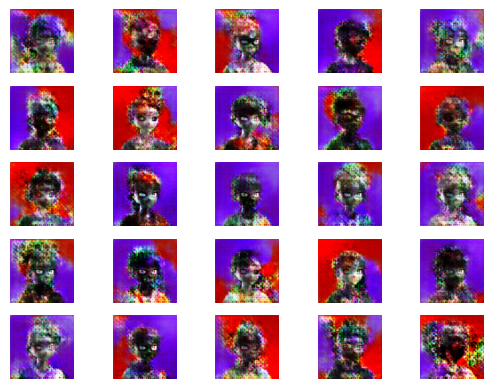

epochs 15
1/1 [==============================] - 0s 20ms/step


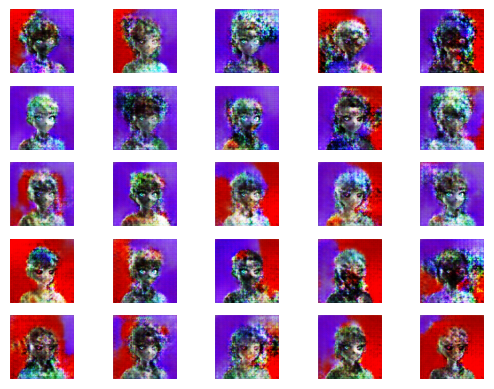

epochs 16
1/1 [==============================] - 0s 21ms/step


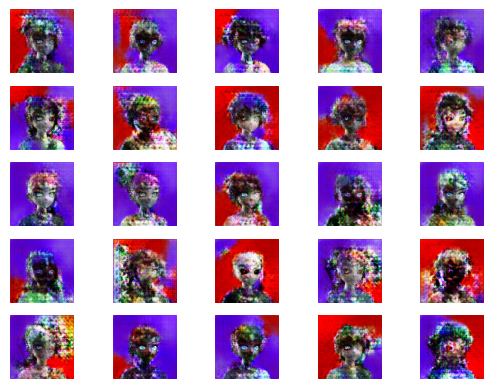

epochs 17
1/1 [==============================] - 0s 21ms/step


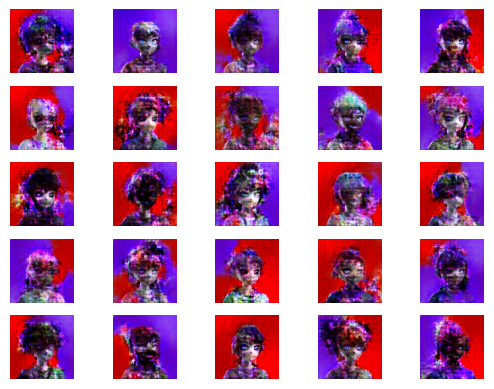

epochs 18
1/1 [==============================] - 0s 21ms/step


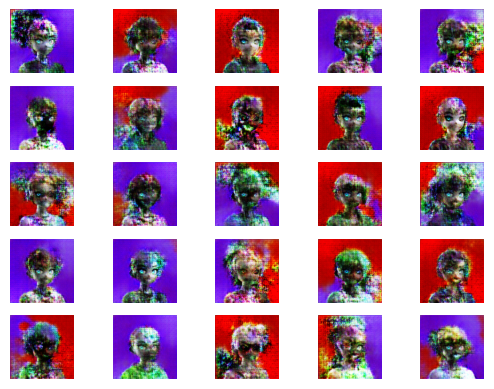

epochs 19
1/1 [==============================] - 0s 21ms/step


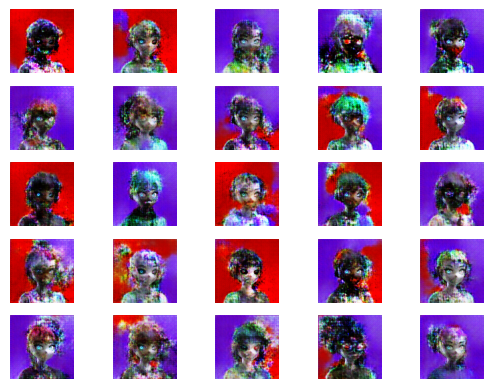

epochs 20
1/1 [==============================] - 0s 20ms/step


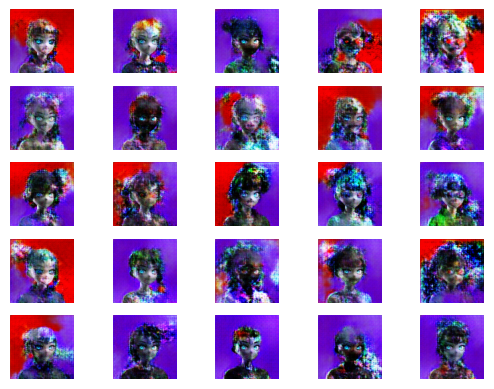

epochs 21
1/1 [==============================] - 0s 20ms/step


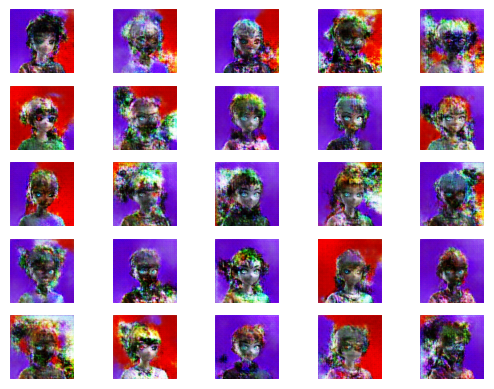

epochs 22
1/1 [==============================] - 0s 21ms/step


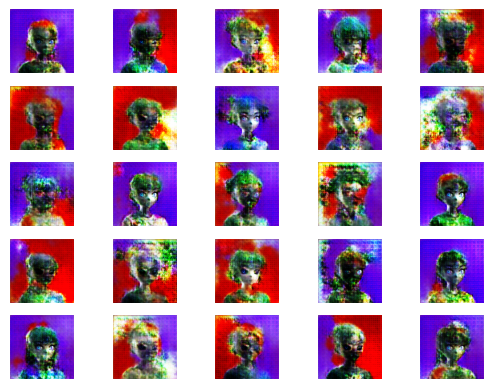

epochs 23
1/1 [==============================] - 0s 20ms/step


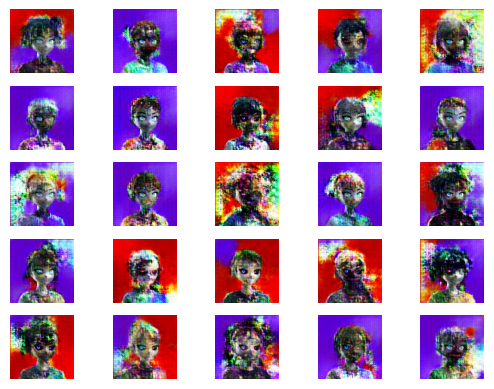

epochs 24
1/1 [==============================] - 0s 21ms/step


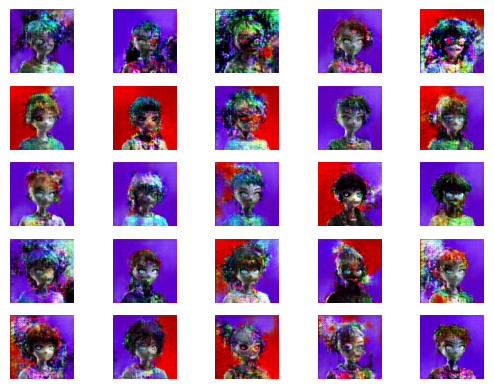

epochs 25
1/1 [==============================] - 0s 20ms/step


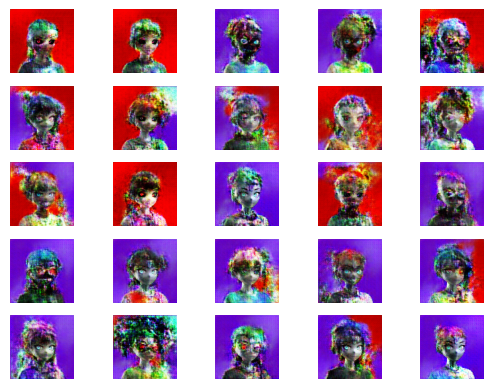

epochs 26
1/1 [==============================] - 0s 21ms/step


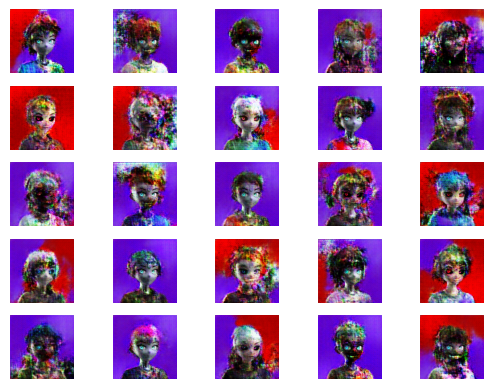

epochs 27
1/1 [==============================] - 0s 20ms/step


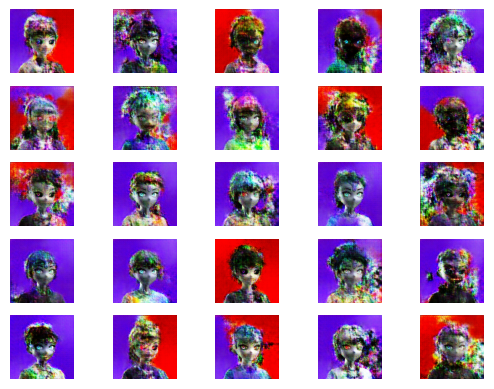

epochs 28
1/1 [==============================] - 0s 20ms/step


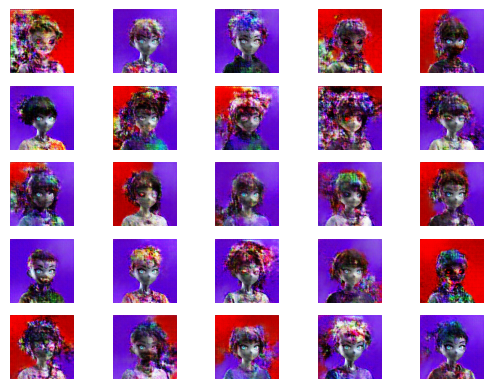

epochs 29
1/1 [==============================] - 0s 21ms/step


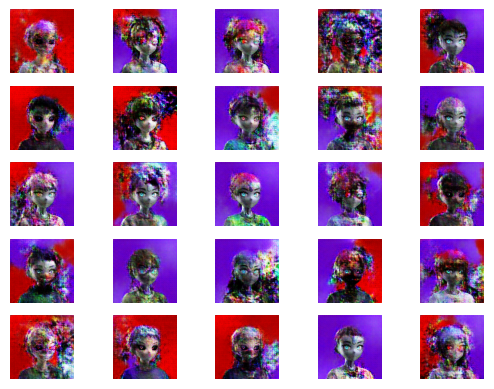

epochs 30
1/1 [==============================] - 0s 21ms/step


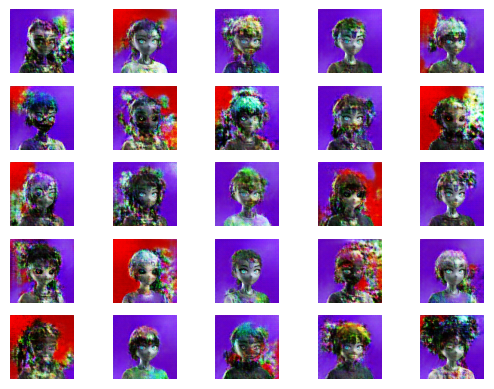

epochs 31
1/1 [==============================] - 0s 20ms/step


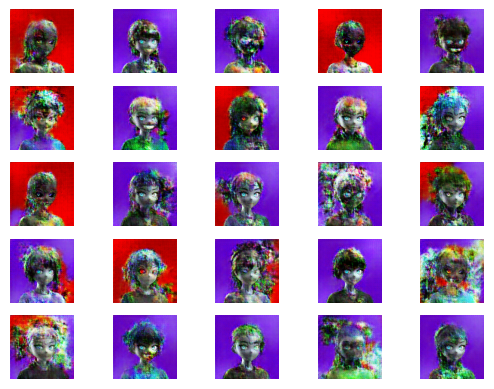

epochs 32
1/1 [==============================] - 0s 23ms/step


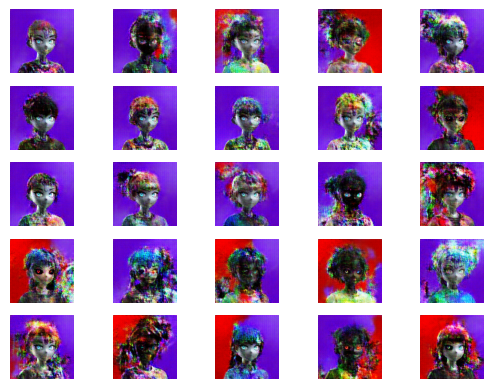

epochs 33
1/1 [==============================] - 0s 21ms/step


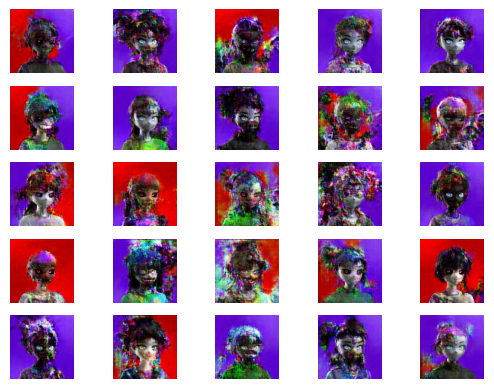

epochs 34
1/1 [==============================] - 0s 20ms/step


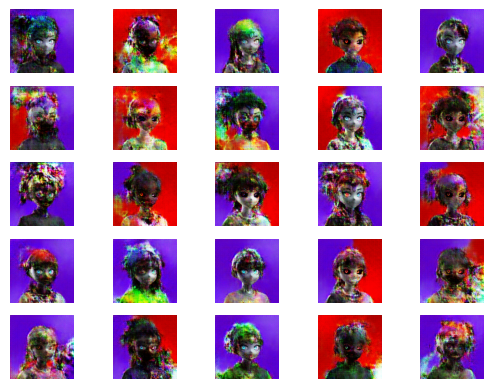

epochs 35
1/1 [==============================] - 0s 21ms/step


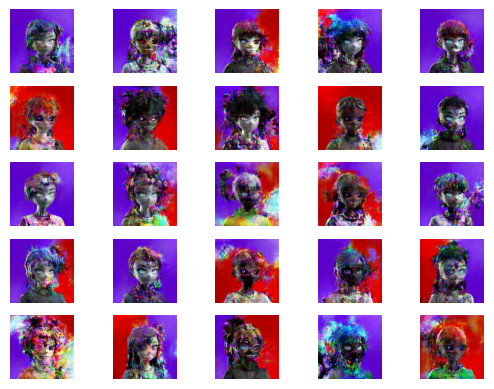

epochs 36
1/1 [==============================] - 0s 21ms/step


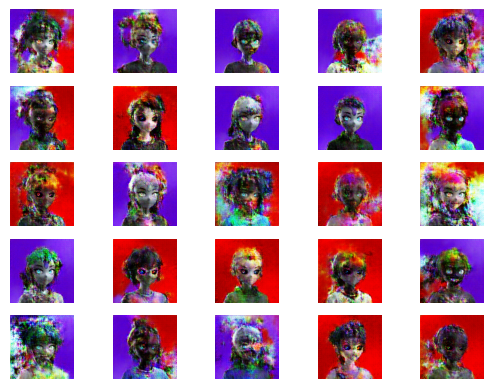

epochs 37
1/1 [==============================] - 0s 20ms/step


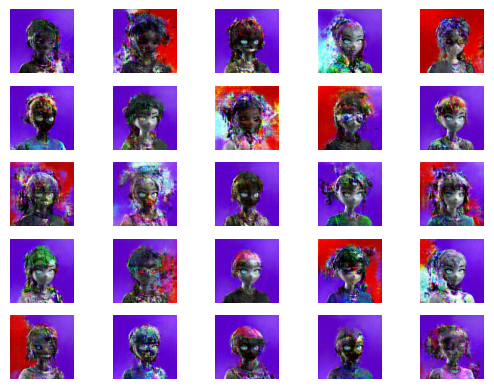

epochs 38
1/1 [==============================] - 0s 20ms/step


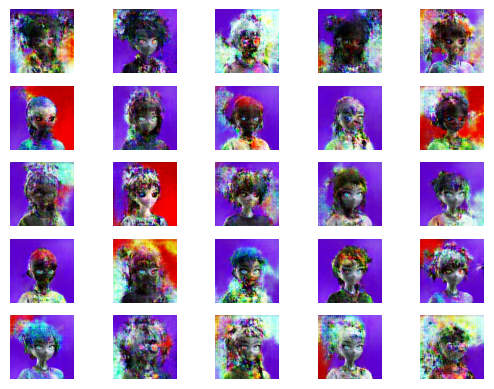

epochs 39
1/1 [==============================] - 0s 21ms/step


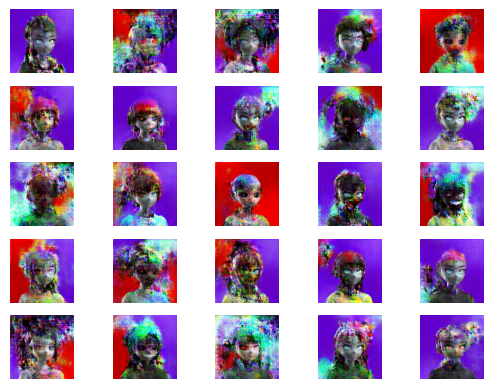

epochs 40
1/1 [==============================] - 0s 20ms/step


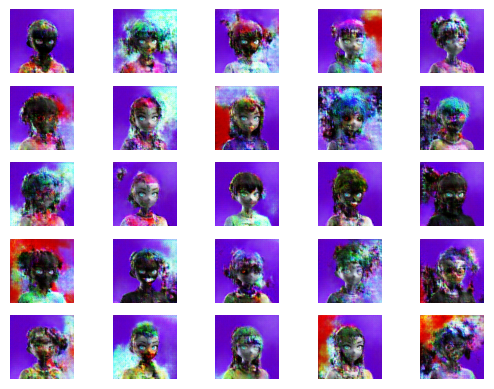

epochs 41
1/1 [==============================] - 0s 37ms/step


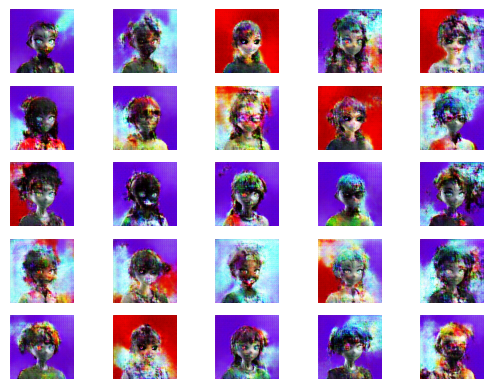

epochs 42
1/1 [==============================] - 0s 21ms/step


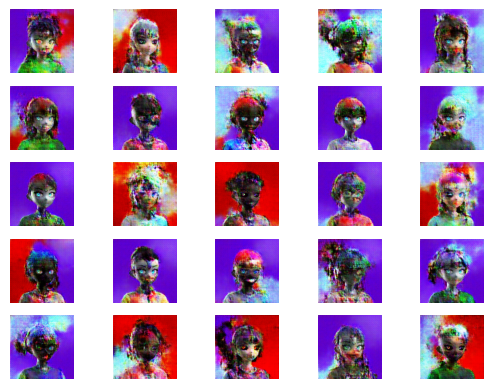

epochs 43
1/1 [==============================] - 0s 31ms/step


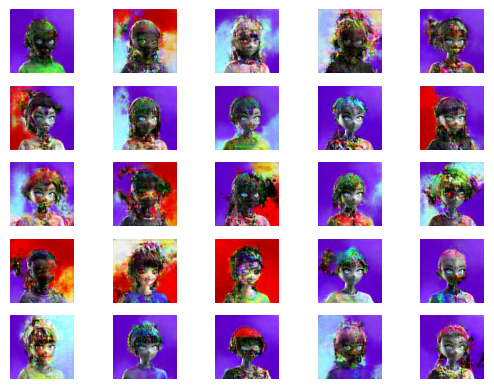

epochs 44
1/1 [==============================] - 0s 20ms/step


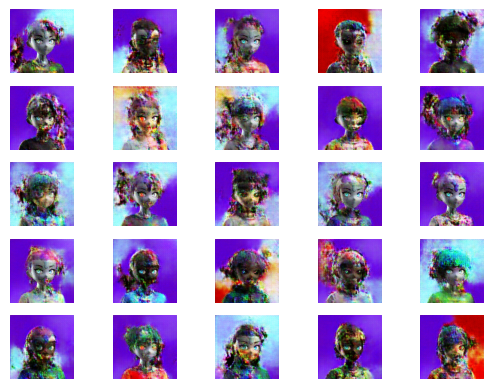

epochs 45
1/1 [==============================] - 0s 21ms/step


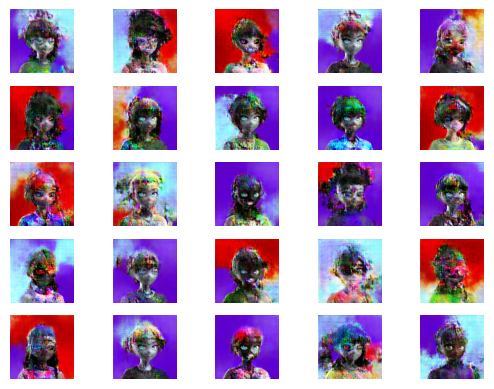

epochs 46
1/1 [==============================] - 0s 20ms/step


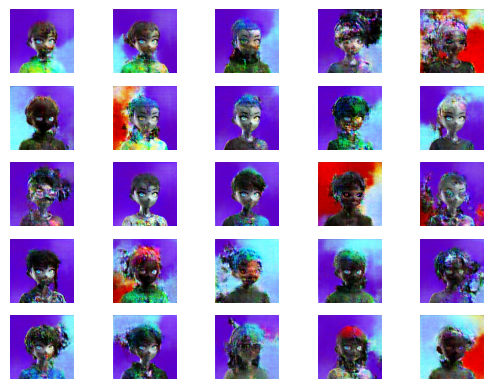

epochs 47
1/1 [==============================] - 0s 24ms/step


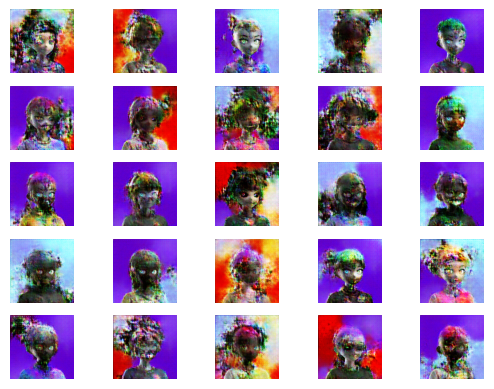

epochs 48
1/1 [==============================] - 0s 23ms/step


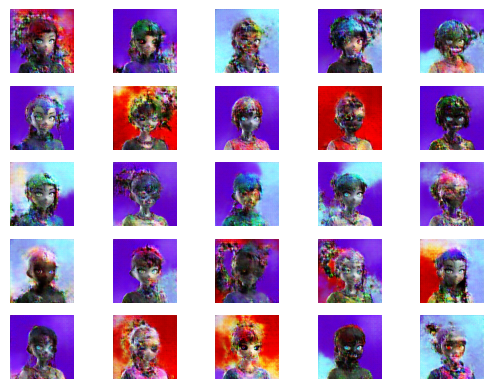

epochs 49
1/1 [==============================] - 0s 20ms/step


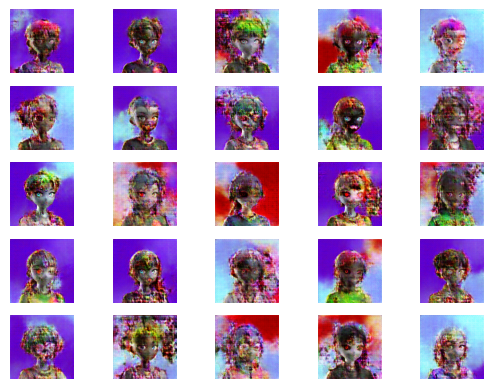

epochs 50
1/1 [==============================] - 0s 20ms/step


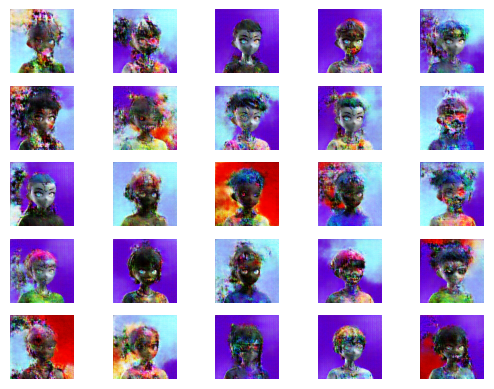

epochs 51
1/1 [==============================] - 0s 20ms/step


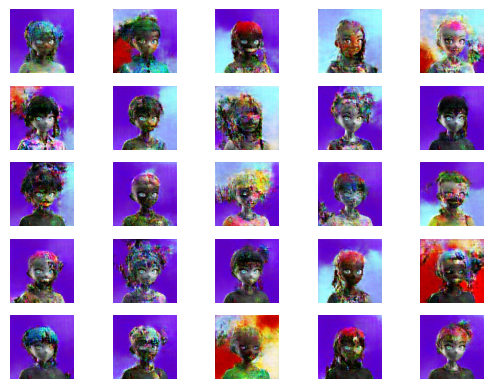

epochs 52
1/1 [==============================] - 0s 21ms/step


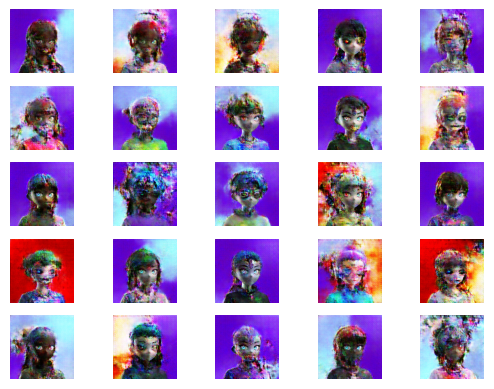

epochs 53
1/1 [==============================] - 0s 21ms/step


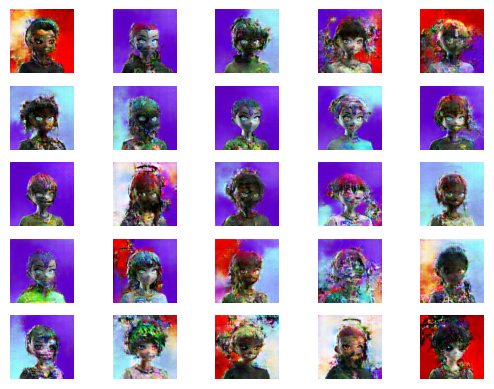

epochs 54
1/1 [==============================] - 0s 21ms/step


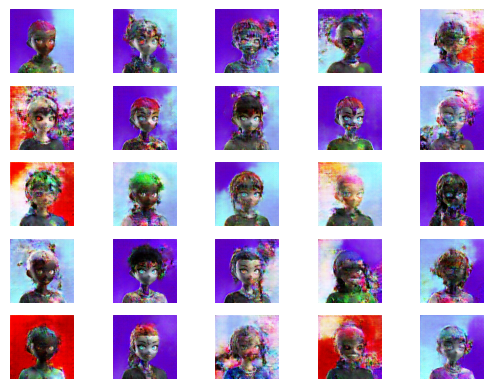

epochs 55
1/1 [==============================] - 0s 21ms/step


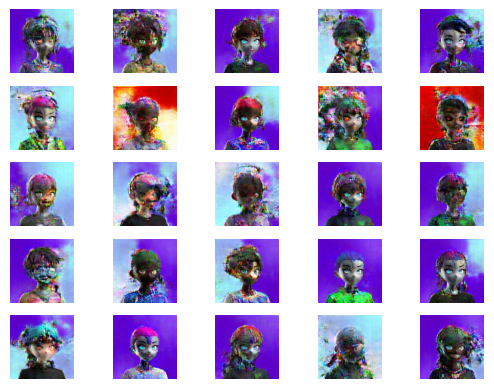

epochs 56
1/1 [==============================] - 0s 20ms/step


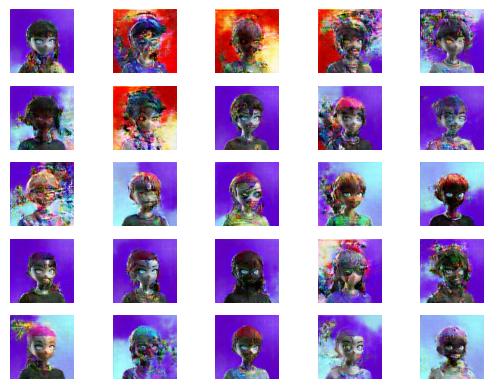

epochs 57
1/1 [==============================] - 0s 20ms/step


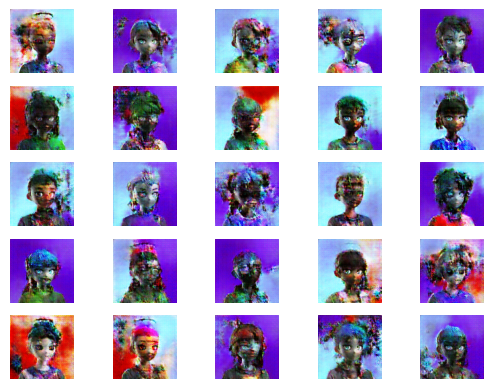

epochs 58
1/1 [==============================] - 0s 22ms/step


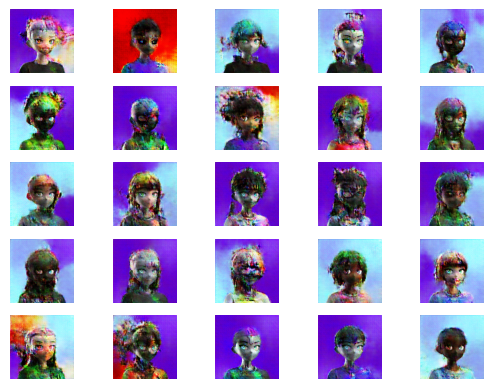

epochs 59
1/1 [==============================] - 0s 21ms/step


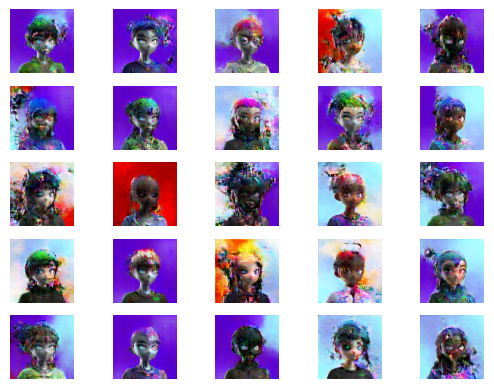

epochs 60
1/1 [==============================] - 0s 20ms/step


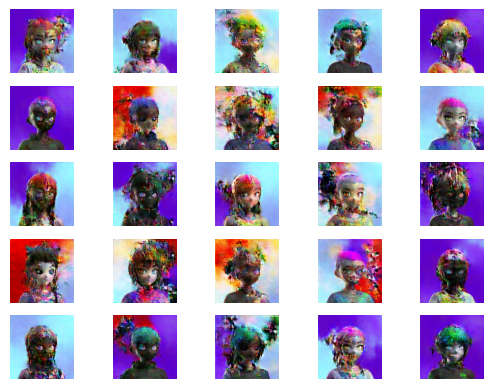

epochs 61
1/1 [==============================] - 0s 21ms/step


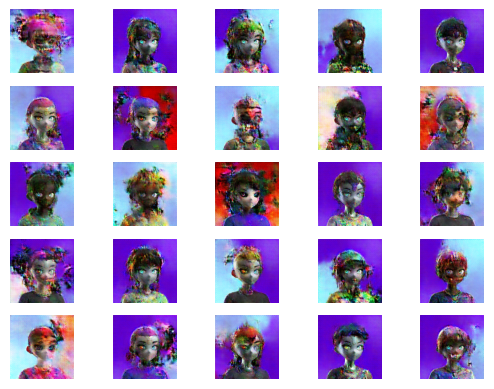

epochs 62
1/1 [==============================] - 0s 20ms/step


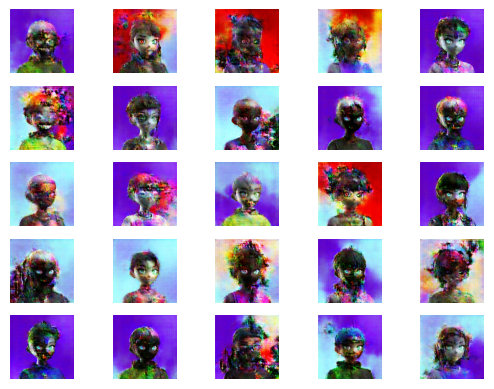

epochs 63
1/1 [==============================] - 0s 20ms/step


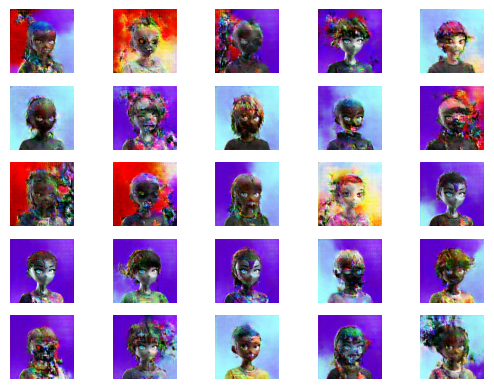

epochs 64
1/1 [==============================] - 0s 20ms/step


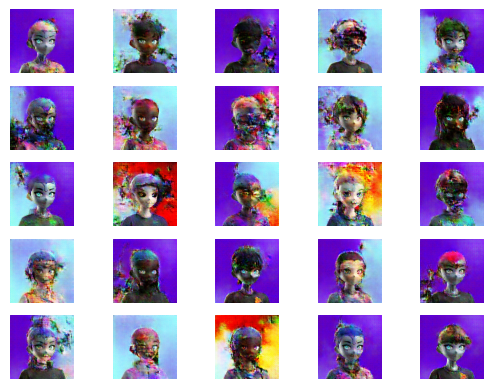

epochs 65
1/1 [==============================] - 0s 21ms/step


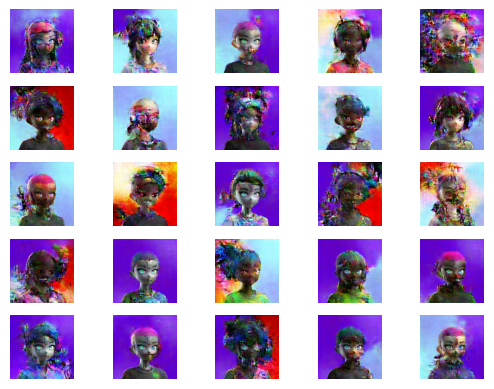

epochs 66
1/1 [==============================] - 0s 20ms/step


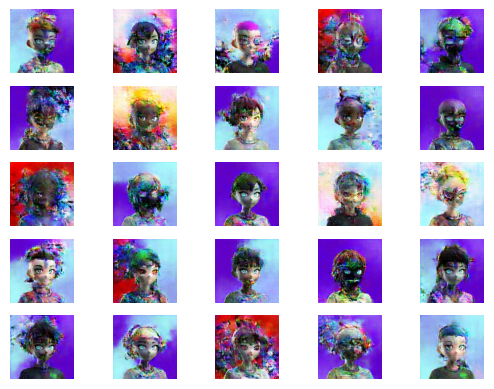

epochs 67
1/1 [==============================] - 0s 20ms/step


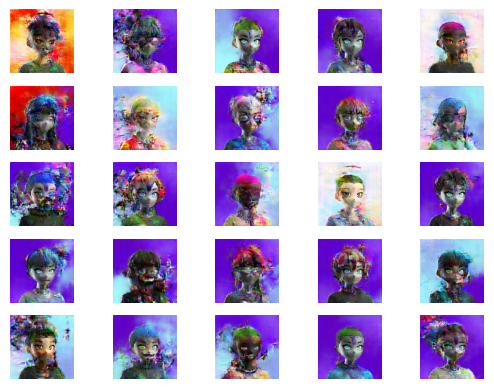

epochs 68
1/1 [==============================] - 0s 20ms/step


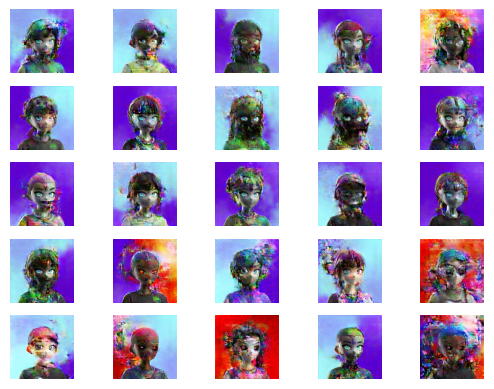

epochs 69
1/1 [==============================] - 0s 20ms/step


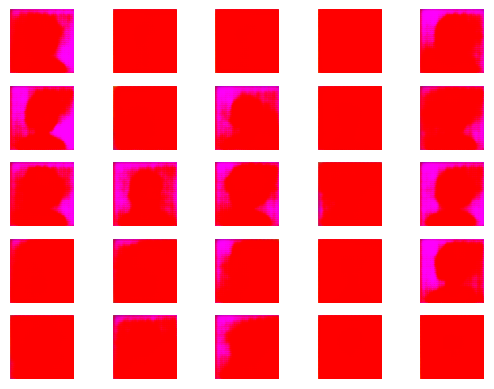

epochs 70
1/1 [==============================] - 0s 20ms/step


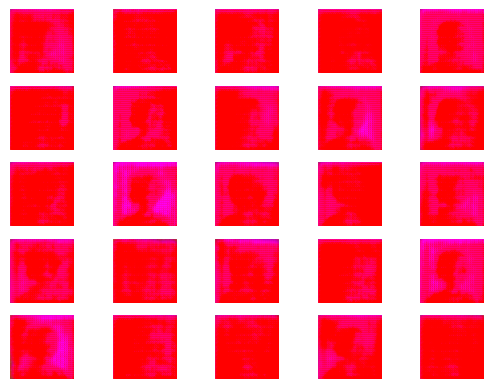

epochs 71
1/1 [==============================] - 0s 21ms/step


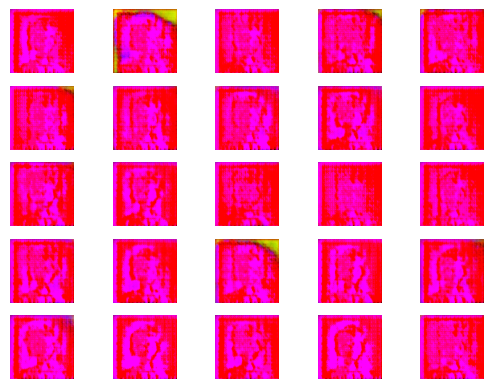

epochs 72
1/1 [==============================] - 0s 20ms/step


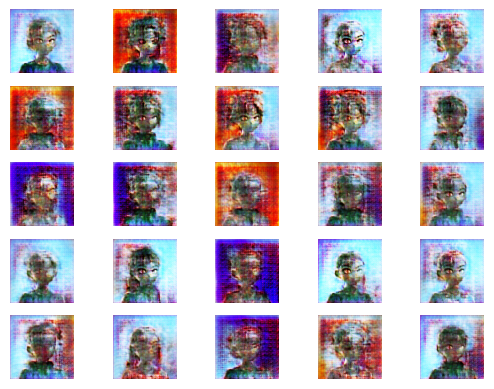

epochs 73
1/1 [==============================] - 0s 20ms/step


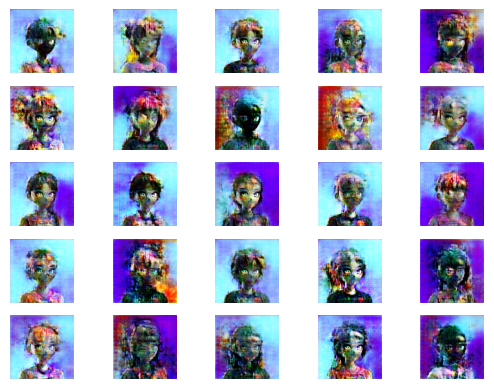

epochs 74
1/1 [==============================] - 0s 20ms/step


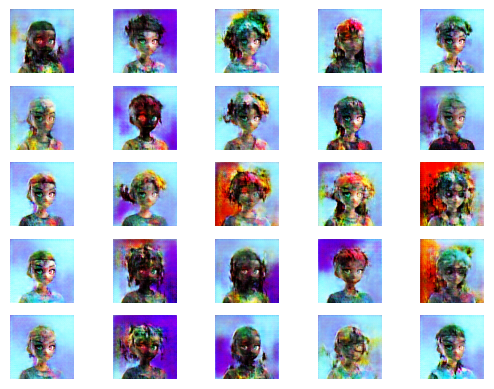

epochs 75
1/1 [==============================] - 0s 20ms/step


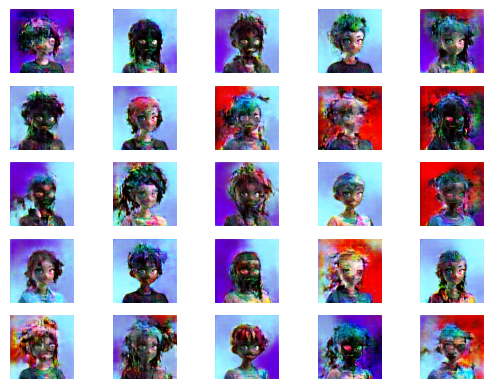

epochs 76
1/1 [==============================] - 0s 20ms/step


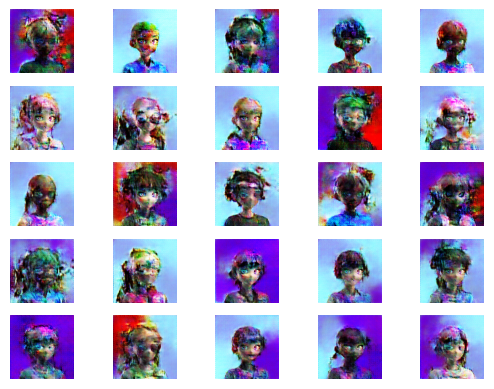

epochs 77
1/1 [==============================] - 0s 20ms/step


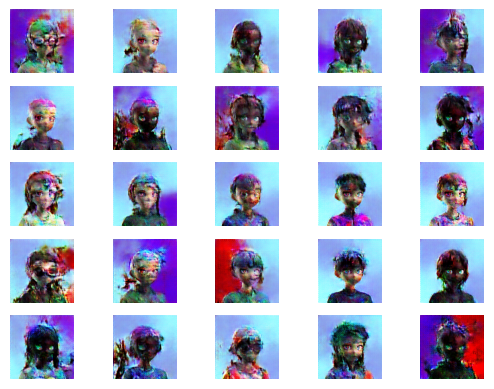

epochs 78
1/1 [==============================] - 0s 20ms/step


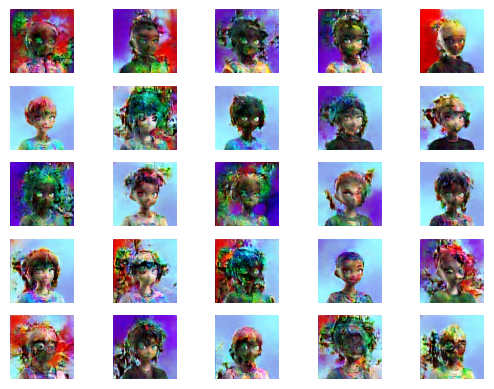

epochs 79
1/1 [==============================] - 0s 20ms/step


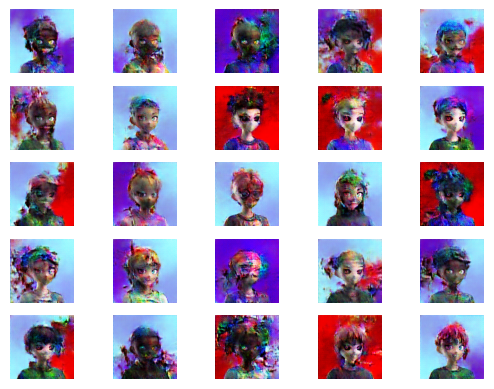

epochs 80
1/1 [==============================] - 0s 20ms/step


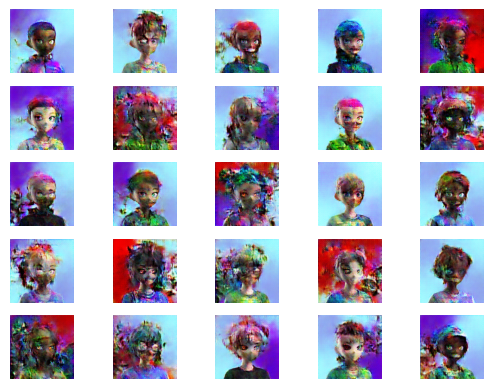

epochs 81
1/1 [==============================] - 0s 21ms/step


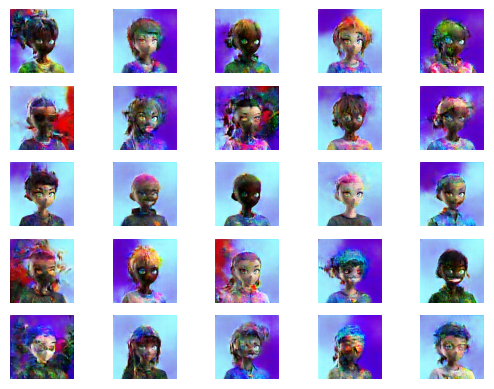

epochs 82
1/1 [==============================] - 0s 20ms/step


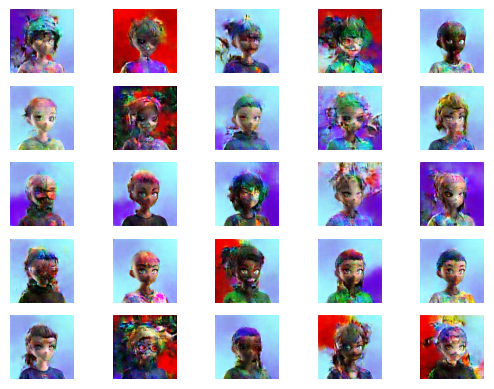

epochs 83
1/1 [==============================] - 0s 21ms/step


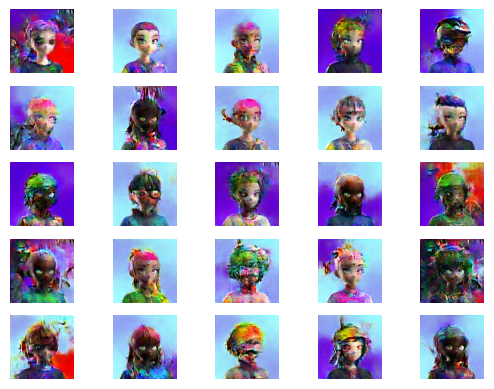

epochs 84
1/1 [==============================] - 0s 21ms/step


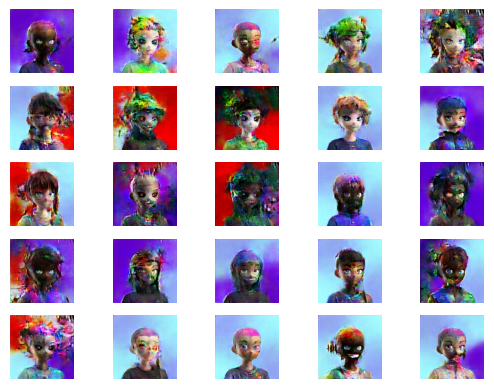

epochs 85
1/1 [==============================] - 0s 21ms/step


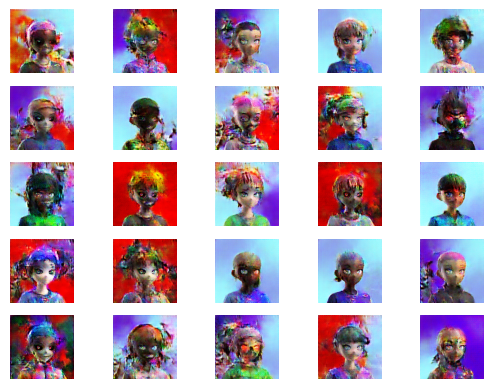

epochs 86
1/1 [==============================] - 0s 20ms/step


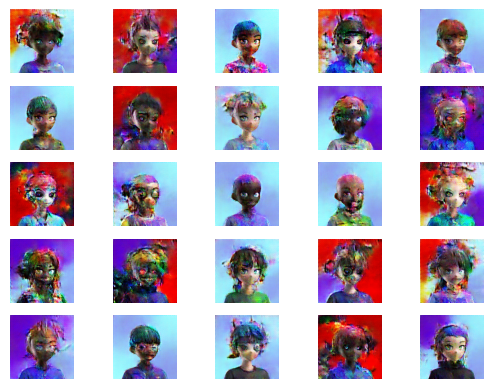

epochs 87
1/1 [==============================] - 0s 20ms/step


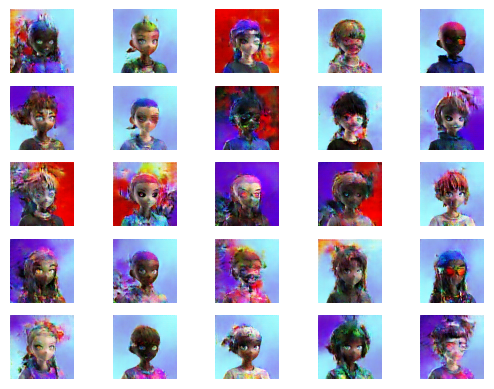

epochs 88
1/1 [==============================] - 0s 32ms/step


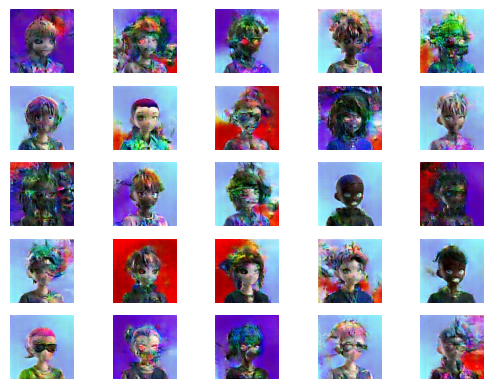

epochs 89
1/1 [==============================] - 0s 20ms/step


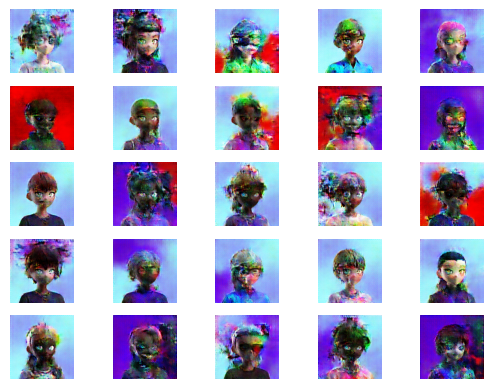

In [27]:
for epoch in range(epochs):
    print(f'epochs {epoch}')
    gan.fit(images_ds, epochs=1)
    gen.save("/kaggle/working/generator_nft.h5")
    disc.save("/kaggle/working/discriminator_nft.h5")
    
    n_samples = 25
    noise = np.random.normal(size=(n_samples, latent_dim))
    examples = gen.predict(noise)
    save_plot(examples, epochs, int(np.sqrt(n_samples)))

# Generate the Images

In [30]:
def save_plot_img(examples, n):
    examples = (examples + 1) / 2.0
    for i in range(n * n):
        plt.subplot(n, n, i+1)
        plt.axis("off")
        plt.imshow(examples[i])
    filename = "fake.png"
    plt.savefig(filename)
    plt.show()

1/1 [==============================] - 0s 155ms/step


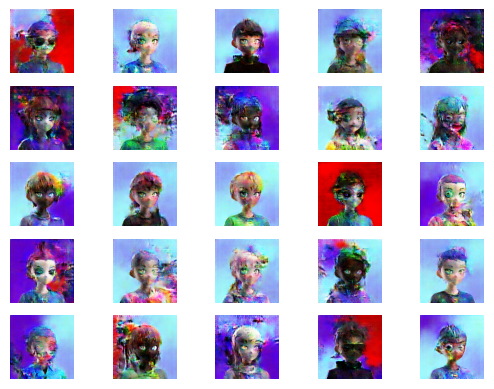

In [33]:
model = tf.keras.models.load_model("/kaggle/working/generator_nft.h5")

n_samples = 25     ## n should always be a square of an integer.
latent_dim = 128
latent_points = np.random.normal(size=(n_samples, latent_dim))
examples = model.predict(latent_points)
save_plot_img(examples, int(np.sqrt(n_samples)))

1/1 [==============================] - 0s 19ms/step


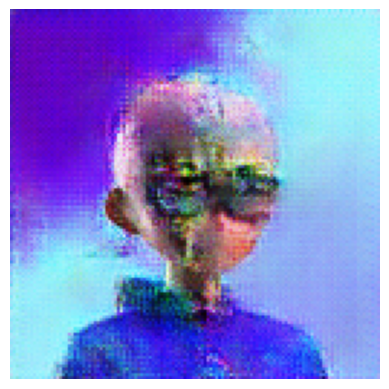

In [39]:
n_samples = 1     ## n should always be a square of an integer.
latent_dim = 128
latent_points = np.random.normal(size=(n_samples, latent_dim))
examples = model.predict(latent_points)
save_plot_img(examples, int(np.sqrt(n_samples)))